In [2]:
import sys
import os

# Set the project root directory
project_root = os.path.abspath("..")   # one level above /notebooks
sys.path.append(project_root)

**Imports**

In [3]:
from collections import defaultdict

from src.dataset import *

import numpy as np 
import random
import pandas as pd
import matplotlib.pyplot as plt

from PIL import Image

**Setting Seed**

In [4]:
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed_all(SEED)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# **Data Exploration**

In [5]:
base_dataset = load_base_dataset("../data/PlantVillage")
base_dataset

Dataset ImageFolder
    Number of datapoints: 20638
    Root location: ../data/PlantVillage

### **Data Cleaning**

##### **Check for Corrupted Images**

In [6]:
def find_corrupted_images(data_dir):
    corrupted = []

    for class_name in os.listdir(data_dir):
        class_dir = os.path.join(data_dir,class_name)

        for img_name in os.listdir(class_dir):
            img_path = os.path.join(class_dir, img_name)

            try:
                img = Image.open(img_path)
                img.verify() 
            
            except:
                corrupted.append(img_path)
        
        return corrupted

In [7]:
corrupted_imgs = find_corrupted_images("../data/PlantVillage")
print(f"Corrupted Images: {len(corrupted_imgs)}")

Corrupted Images: 0


##### **Check for Image Size Distribtions**

In [8]:
sizes = []
for img, label in base_dataset:
    sizes.append(img.size)

pd.Series(sizes).value_counts()

(256, 256)    20638
Name: count, dtype: int64

##### **Check for Brightness Levels**

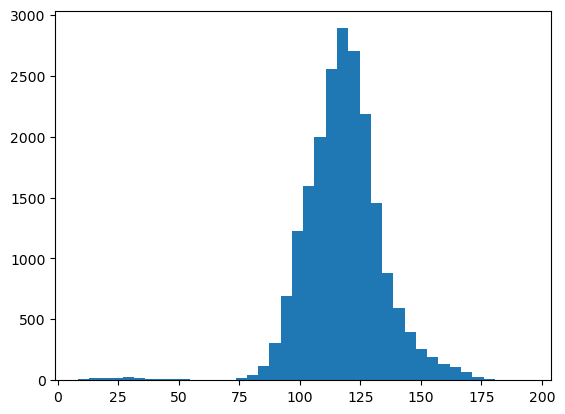

In [9]:
def compute_brightness(img):
    img_gray = img.convert("L") # converts the image to grayscale
    img_gray_arr = np.array(img_gray)
    brightness = np.mean(img_gray_arr)
    return brightness

brightness_list = []
brightness_values = []

for img_path, label in base_dataset:
    brightness = compute_brightness(img_path)
    brightness_list.append((img_path, brightness))
    brightness_values.append(brightness)

plt.hist(brightness_values, bins=40)
plt.show()

**Images Below Brightness Threshold**  
None of these Images need to be removed as the leaves are still clearly visible

In [10]:
threshold = 30
outliers = [(path, b) for path, b in brightness_list if b < threshold]

In [11]:
len(outliers)

79

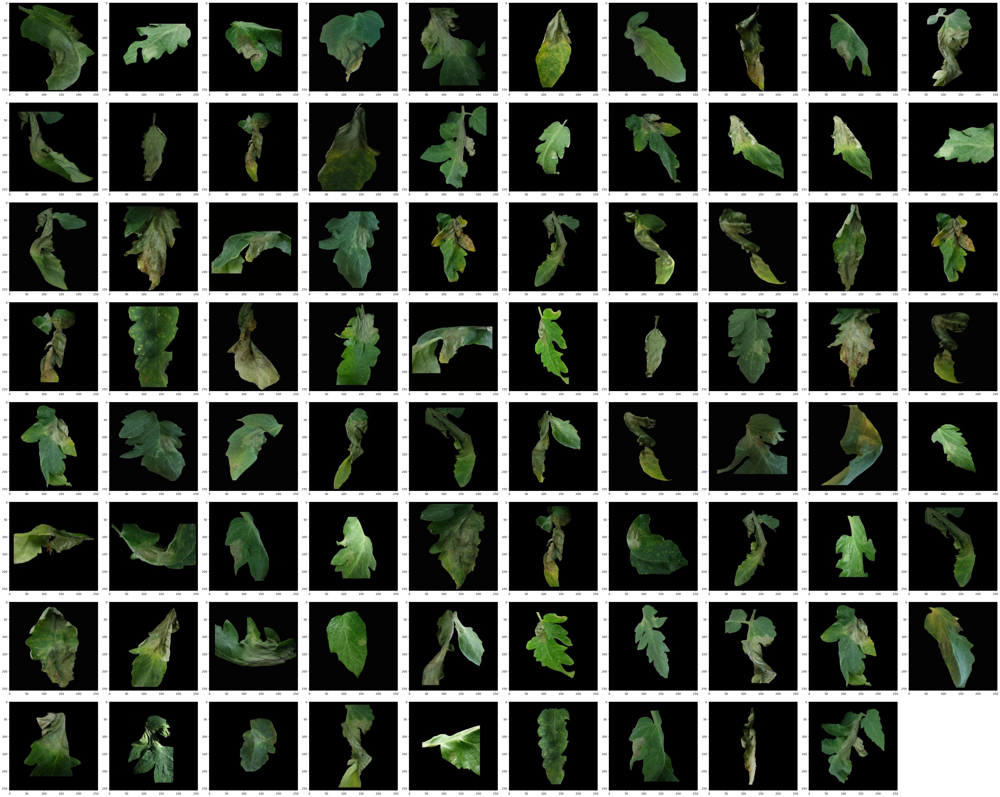

In [12]:
cols = 10
rows = len(outliers) // cols if len(outliers) % cols == 0 else len(outliers) // cols + 1
plt.figure(figsize=(cols*5,rows*5)) 
for i,(img,_) in enumerate(outliers):
    plt.subplot(rows,cols,i+1)
    plt.imshow(img)
    
plt.tight_layout()
plt.show()
    

**Images Above Brightness Threshold**  
None of these Images need to be removed as the leaves are still clearly visible

In [15]:
max_threshold = 170
outliers_above_max_threshold = [(path, b) for path, b in brightness_list if b > max_threshold]
len(outliers_above_max_threshold)

65

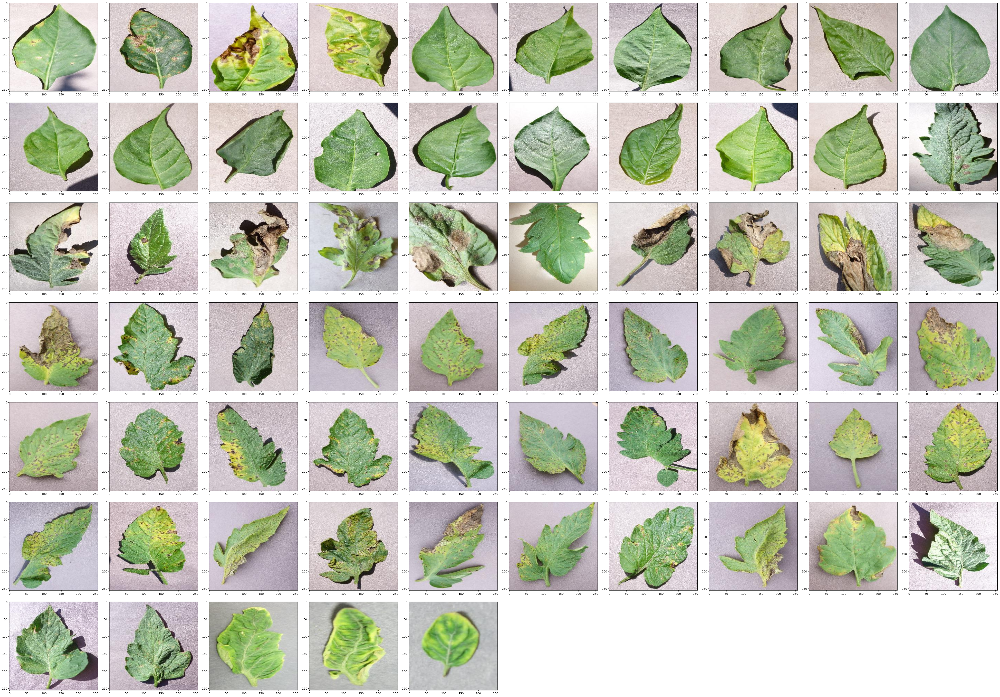

In [16]:
cols = 10
rows = len(outliers_above_max_threshold) // cols if len(outliers_above_max_threshold) % cols == 0 else len(outliers_above_max_threshold) // cols + 1
plt.figure(figsize=(cols*5,rows*5)) 
for i,(img,_) in enumerate(outliers_above_max_threshold):
    plt.subplot(rows,cols,i+1)
    plt.imshow(img)
    
plt.tight_layout()
plt.show()